# LDA

# Step 1: Install Dependencies

This step will:
* Install required Python packages for the LDA topic modeling project:
  * `tqdm` - For progress bars when processing large datasets
  * `wordcloud` - For visualizing word frequency in topics
  * `nltk` - For natural language processing tasks
  * `scikit-learn` - For text vectorization
  * `matplotlib` and `seaborn` - For data visualization
  * `boto3` - For AWS services integration

After this step, all required Python libraries will be installed in your environment and ready for use in the notebook.

In [1]:
# Install all required packages
!pip install tqdm wordcloud nltk scikit-learn matplotlib seaborn boto3 --quiet

# Step 2: Imports and Setup

This step will:
* Import standard libraries needed throughout the workflow:
  * File handling: `os`, `io`, `json`
  * Text processing: `re`
  * System utilities: `time`, `logging`, `datetime`
* Import data processing and visualization libraries:
  * Data manipulation: `numpy`, `pandas`
  * Visualization: `matplotlib`, `seaborn`, `wordcloud`
  * Progress tracking: `tqdm`
* Import NLP libraries:
  * Text processing tools from `nltk`
  * Text vectorization from `sklearn`
* Import AWS and SageMaker tools:
  * AWS SDK: `boto3`
  * SageMaker: Various modules for model training and deployment
* Download NLTK resources needed for text processing:
  * Stopwords, tokenizers, and lemmatization dictionaries
* Configure logging for better tracking of the execution flow

After this step, all necessary libraries will be imported, NLTK resources will be downloaded, and logging will be configured to track progress throughout the notebook execution.

In [2]:
# Standard libraries
import os
import io
import json
import re
import time
import logging
from datetime import datetime
# Data processing and visualization
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
from tqdm import tqdm
# NLP libraries
import nltk
from nltk.tokenize import RegexpTokenizer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
from sklearn.feature_extraction.text import CountVectorizer
# AWS and SageMaker
import boto3
import sagemaker
from sagemaker import get_execution_role, image_uris
from sagemaker.estimator import Estimator
from sagemaker.amazon.common import write_spmatrix_to_sparse_tensor
from sagemaker.s3 import S3Uploader
from botocore.exceptions import ClientError

# Apply patch for NumPy bool deprecation before importing MXNet
# This is necessary because MXNet still uses the deprecated np.bool
import numpy as np
if not hasattr(np, 'bool'):
    np.bool = bool

# Now import MXNet
import mxnet as mx

# Download NLTK resources
nltk.download("stopwords", quiet=True)
nltk.download("punkt", quiet=True)
nltk.download("wordnet", quiet=True)
# Setup logging
logging.basicConfig(level=logging.INFO, format="%(asctime)s %(levelname)s: %(message)s")
logger = logging.getLogger(__name__)

/home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/pydantic/_internal/_fields.py:198: UserWarning: Field name "json" in "MonitoringDatasetFormat" shadows an attribute in parent "Base"
  warnings.warn(


[04/04/25 13:12:18] INFO     Found credentials from IAM Role:                                   ]8;id=364708;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py\credentials.py]8;;\:]8;id=528684;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py#1132\1132]8;;\
                             BaseNotebookInstanceEc2InstanceRole                                                   

sagemaker.config INFO - Not applying SDK defaults from location: /etc/xdg/sagemaker/config.yaml
sagemaker.config INFO - Not applying SDK defaults from location: /home/ec2-user/.config/sagemaker/config.yaml


/tmp/ipykernel_1981/4184642392.py:34: FutureWarning: In the future `np.bool` will be defined as the corresponding NumPy scalar.
  if not hasattr(np, 'bool'):


# Step 3: Configuration

This step will:
* Set up global NLP constants:
  * Stop words: Common words to filter out
  * Lemmatizer: For reducing words to their root form
  * Tokenizer: For breaking text into individual tokens
* Configure input/output paths:
  * Input folder: Where your text files are stored
  * Run label: Unique identifier for this execution
  * Local output directory: Where results will be saved
* Set text vectorization parameters:
  * Maximum features: Vocabulary size limit
  * Document frequency thresholds: Minimum and maximum appearance rates
* Define LDA model hyperparameters:
  * Number of topics: How many topics to extract (set to 3)
  * Training epochs: Number of training iterations
  * Batch size: Data processing chunk size
  * Instance type: AWS machine type for deployment
* Configure deployment options:
  * Whether to deploy a real-time endpoint
  * Model and endpoint naming
  * Resource cleanup preferences
* Initialize SageMaker session and AWS clients:
  * Set up S3 bucket, region, and IAM role 
  * Create necessary client connections
* Define S3 paths for model artifacts

After this step, all configuration parameters will be set for the LDA workflow, including NLP preprocessing settings, model hyperparameters, and AWS deployment options. You can modify these parameters to adapt to your specific dataset and requirements.

In [3]:
# Global constants
STOP_WORDS = set(stopwords.words("english"))
LEMMATIZER = WordNetLemmatizer()
TOKENIZER = RegexpTokenizer(r"\b\w{3,}\b")

# Input/output configuration
input_folder = "lda_texts"  # Change this to your local folder with .txt files
run_label = "lda-realtime-" + datetime.now().strftime("%Y%m%d-%H%M")
local_output_dir = f"./lda_output_{run_label}"
os.makedirs(local_output_dir, exist_ok=True)

# Vectorizer parameters
max_features = 1000
min_df = 2   
max_df = 0.90

# LDA model parameters
num_topics = 3
epochs = 100
mini_batch_size = 512
deploy_instance_type = "ml.m5.large"
num_top_words = 15

# Deployment options
deploy_realtime_endpoint = True
fixed_model_name = "lda-model"
fixed_endpoint_name = "lda-endpoint"
cleanup_resources = False

# SageMaker setup
sagemaker_session = sagemaker.Session()
bucket = sagemaker_session.default_bucket()
region = sagemaker_session.boto_region_name
role = get_execution_role()
sagemaker_client = boto3.client("sagemaker", region_name=region)
s3_client = boto3.client("s3", region_name=region)

# S3 paths
base_s3_prefix = f"sagemaker-lda/{run_label}"
base_job_name = f"lda-{run_label}"
model_name = fixed_model_name
endpoint_name = fixed_endpoint_name

[04/04/25 13:12:20] INFO     Found credentials from IAM Role:                                   ]8;id=106472;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py\credentials.py]8;;\:]8;id=173673;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py#1132\1132]8;;\
                             BaseNotebookInstanceEc2InstanceRole                                                   

[04/04/25 13:12:21] INFO     Found credentials from IAM Role:                                   ]8;id=491990;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py\credentials.py]8;;\:]8;id=9033;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py#1132\1132]8;;\
                             BaseNotebookInstanceEc2InstanceRole                                                   

[04/04/25 13:12:22] INFO     Found credentials from IAM Role:                                   ]8;id=305799;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py\credentials.py]8;;\:]8;id=946034;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/botocore/credentials.py#1132\1132]8;;\
                             BaseNotebookInstanceEc2InstanceRole                                                   

# Step 4: Text Preprocessing Functions

This step will:
* Define core text processing functions:
  * `preprocess_text()`: Cleans and normalizes individual text documents by:
    * Converting to lowercase
    * Removing URLs and HTML tags
    * Removing non-alphabetic characters
    * Normalizing whitespace
    * Tokenizing words
    * Lemmatizing words (reducing to base forms)
    * Removing stopwords
  * `load_and_preprocess_documents()`: Processes all text files in a folder:
    * Reads each .txt file line by line
    * Applies preprocessing to each line
    * Creates a mapping between filenames and their processed content
  * `vectorize_documents()`: Converts text to a document-term matrix:
    * Creates a sparse matrix representing word frequencies
    * Applies vocabulary filtering based on document frequency
    * Returns the matrix, vocabulary list, and vectorizer object
  * `upload_sparse_matrix_to_s3()`: Prepares and uploads data to S3:
    * Converts a sparse matrix to SageMaker's recordIO format
    * Uploads the converted data to the specified S3 location

After this step, you'll have all the necessary functions to preprocess text data, convert it to a format suitable for LDA modeling, and upload it to S3 for SageMaker processing. These functions handle the transformation from raw text files to the prepared matrices that the LDA algorithm requires.

In [4]:
def preprocess_text(text):
    """
    Lowercase text, remove URLs, HTML tags, non-alpha chars, and extra whitespace.
    Tokenize, lemmatize, and remove stopwords.
    """
    text = text.lower()
    text = re.sub(r"http\S+|www\.\S+", "", text)
    text = re.sub(r"<.*?>", " ", text)
    text = re.sub(r"[^a-z\s]", " ", text)
    text = re.sub(r"\s+", " ", text).strip()
    tokens = TOKENIZER.tokenize(text)
    return " ".join([LEMMATIZER.lemmatize(t) for t in tokens if t not in STOP_WORDS])

def load_and_preprocess_documents(folder):
    """
    Loads each .txt file in the folder, preprocesses line by line.
    Returns:
      docs: list of all processed lines across files
      file_doc_map: dict mapping filename -> list of processed lines
    """
    docs = []
    file_doc_map = {}

    for fname in os.listdir(folder):
        if fname.endswith(".txt"):
            file_path = os.path.join(folder, fname)
            with open(file_path, "r", encoding="utf-8") as f:
                file_lines = []
                for line in f:
                    cleaned = preprocess_text(line)
                    if cleaned:
                        docs.append(cleaned)
                        file_lines.append(cleaned)
                file_doc_map[fname] = file_lines
    return docs, file_doc_map

def vectorize_documents(docs):
    """
    Creates a document-term matrix using CountVectorizer.
    """
    vectorizer = CountVectorizer(
        max_features=max_features,
        min_df=min_df,
        max_df=max_df,
        stop_words=None
    )
    dtm = vectorizer.fit_transform(docs)
    vocab = vectorizer.get_feature_names_out()
    return dtm, vocab, vectorizer

def upload_sparse_matrix_to_s3(sparse_matrix, s3_path):
    """
    Converts a sparse matrix to a recordIO protobuf and uploads it to S3.
    """
    buffer = io.BytesIO()
    write_spmatrix_to_sparse_tensor(buffer, sparse_matrix)
    buffer.seek(0)
    bucket_name, key = s3_path.replace("s3://", "").split("/", 1)
    s3_client.upload_fileobj(buffer, bucket_name, key)
    return s3_path

# Step 5: Load and Prepare Data

This step will:
* Load documents from the specified input folder:
  * Read all .txt files in the directory
  * Process each document through the preprocessing pipeline
* Create a document-term matrix:
  * Apply the CountVectorizer to convert text to a term frequency matrix
  * Extract the vocabulary (terms) used in the vectorization
  * Calculate the feature dimension (vocabulary size)
* Log information about the loaded dataset:
  * Number of documents processed
  * Feature dimension size
* Upload the prepared data to S3:
  * Convert the document-term matrix to SageMaker's expected format
  * Store the prepared data in the configured S3 bucket and path

After this step, your text data will be fully preprocessed and uploaded to S3, ready for LDA model training. The document-term matrix, vocabulary, and document mappings will be available in memory for later analysis and visualization.

In [5]:
# Load and preprocess documents
docs, file_doc_map = load_and_preprocess_documents(input_folder)
dtm, vocab, vectorizer = vectorize_documents(docs)
feature_dim = dtm.shape[1]

logger.info(f"Loaded {len(docs)} documents. Feature dim: {feature_dim}")

# Upload training data to S3
s3_train_uri = f"s3://{bucket}/{base_s3_prefix}/train/train_data.protobuf"
upload_sparse_matrix_to_s3(dtm, s3_train_uri)

[04/04/25 13:12:28] INFO     Loaded 8960 documents. Feature dim: 1000                               ]8;id=164717;file:///tmp/ipykernel_1981/2250120807.py\2250120807.py]8;;\:]8;id=946488;file:///tmp/ipykernel_1981/2250120807.py#6\6]8;;\

's3://sagemaker-us-east-1-042610003076/sagemaker-lda/lda-realtime-20250404-1312/train/train_data.protobuf'

# Step 6: Train LDA Model

This step will:
* Retrieve the LDA algorithm container image:
  * Get the appropriate Docker image URI for SageMaker's built-in LDA algorithm
* Create a SageMaker Estimator:
  * Configure the training job parameters
  * Set the instance type for training
  * Define S3 paths for output
  * Set LDA hyperparameters:
    * Number of topics (3 by default)
    * Feature dimension
    * Mini-batch size
    * Number of training epochs
* Launch the training job:
  * Start model training on the prepared data
  * SageMaker will handle the distributed training process

After this step, SageMaker will train the LDA model on your document-term matrix. The training process will extract the specified number of topics from your corpus. Upon completion, the trained model artifacts will be stored in S3, ready for analysis or deployment.

In [6]:
# Get the LDA algorithm container
lda_image_uri = image_uris.retrieve("lda", region)

# Create and train the estimator
estimator = Estimator(
    image_uri=lda_image_uri,
    role=role,
    instance_count=1,
    instance_type="ml.m5.xlarge",
    output_path=f"s3://{bucket}/{base_s3_prefix}/output-train",
    base_job_name=base_job_name,
    sagemaker_session=sagemaker_session,
    hyperparameters={
        "num_topics": num_topics,
        "feature_dim": feature_dim,
        "mini_batch_size": mini_batch_size,
        "epochs": epochs
    }
)

# Train the model
estimator.fit({"train": s3_train_uri})

[04/04/25 13:12:29] INFO     Same images used for training and inference. Defaulting to image     ]8;id=141737;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/image_uris.py\image_uris.py]8;;\:]8;id=869245;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/image_uris.py#393\393]8;;\
                             scope: inference.                                                                     

                    INFO     Ignoring unnecessary instance type: None.                            ]8;id=824718;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/image_uris.py\image_uris.py]8;;\:]8;id=147215;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/image_uris.py#530\530]8;;\

[04/04/25 13:12:30] INFO     SageMaker Python SDK will collect telemetry to help us better  ]8;id=279605;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/telemetry/telemetry_logging.py\telemetry_logging.py]8;;\:]8;id=861135;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/telemetry/telemetry_logging.py#91\91]8;;\
                             understand our user's needs, diagnose issues, and deliver                             
                             additional features.                                                                  
                             To opt out of telemetry, please disable via TelemetryOptOut                           
                             parameter in SDK defaults config. For more information, refer                         
                             to                                                                                    
                             https://sagemaker.readthedocs.io/en/stable/overview.html#confi                        
                             guring-and-using-defaults-with-the-sagemaker-python-sdk.                              

                    INFO     Creating training-job with name:                                       ]8;id=5621;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py\session.py]8;;\:]8;id=786600;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py#1042\1042]8;;\
                             lda-lda-realtime-20250404-1312-2025-04-04-13-12-30-026                                

2025-04-04 13:12:31 Starting - Starting the training job...
2025-04-04 13:12:46 Starting - Preparing the instances for training...
2025-04-04 13:13:27 Downloading - Downloading the training image.........
2025-04-04 13:14:38 Training - Training image download completed. Training in progress.Docker entrypoint called with argument(s): train
/opt/amazon/lib/python3.7/site-packages/jsonref.py:8: DeprecationWarning: Using or importing the ABCs from 'collections' instead of from 'collections.abc' is deprecated since Python 3.3,and in 3.9 it will stop working
  from collections import Mapping, MutableMapping, Sequence
[04/04/2025 13:14:50 INFO 140430386624320] Reading default configuration from /opt/amazon/lib/python3.7/site-packages/algorithm/resources/default-input.json: {'alpha0': '1.0', 'max_restarts': '10', 'max_iterations': '1000', 'tol': '1e-8', 'allow_svd_init': 'true', 'epochs': '1', '_kvstore': 'local', '_num_gpus': 'auto', '_tuning_objective_metric': ''}
[04/04/2025 13:14:50 INFO 1

# Step 7: Endpoint Deployment Functions

This step will:
* Define functions to manage SageMaker endpoints:
  * `cleanup_previous_deployment()`: Removes existing resources with the same names
    * Deletes any endpoint with the specified name
    * Deletes endpoint configurations
    * Deletes model artifacts
    * Handles appropriate error cases
  * `wait_for_endpoint_deletion()`: Ensures endpoint deletion is complete
    * Polls the endpoint status until it's confirmed deleted
    * Implements timeout handling
    * Provides logging for the deletion progress

After this step, you'll have utility functions to manage deployment lifecycle, particularly for cleaning up previous deployments before creating new ones. These functions ensure that you can repeatedly run the notebook without resource name conflicts and handle the asynchronous nature of endpoint operations.

In [7]:
def cleanup_previous_deployment(endpoint_name, model_name):
    """Delete any existing endpoint, endpoint config, and model with the specified names."""
    try:
        sagemaker_client.delete_endpoint(EndpointName=endpoint_name)
        logger.info(f"Deleted existing endpoint: {endpoint_name}")
    except ClientError as e:
        if "Could not find" not in str(e):
            logger.warning(f"Error deleting endpoint: {e}")

    try:
        sagemaker_client.delete_endpoint_config(EndpointConfigName=endpoint_name)
        logger.info(f"Deleted existing endpoint config: {endpoint_name}")
    except ClientError as e:
        if "Could not find" not in str(e):
            logger.warning(f"Error deleting endpoint config: {e}")

    try:
        sagemaker_client.delete_model(ModelName=model_name)
        logger.info(f"Deleted existing model: {model_name}")
    except ClientError as e:
        if "Could not find" not in str(e):
            logger.warning(f"Error deleting model: {e}")

def wait_for_endpoint_deletion(endpoint_name, timeout=300):
    """Wait for the endpoint to be fully deleted."""
    start_time = time.time()
    while time.time() - start_time < timeout:
        try:
            response = sagemaker_client.describe_endpoint(EndpointName=endpoint_name)
            status = response["EndpointStatus"]
            logger.info(f"Waiting for endpoint deletion. Current status: {status}")
            time.sleep(10)
        except ClientError as e:
            if "Could not find" in str(e) or "ValidationException" in str(e):
                logger.info("Endpoint successfully deleted.")
                return
            else:
                logger.warning(f"Unexpected error while waiting for deletion: {e}")
                raise e
    raise TimeoutError(f"Timeout waiting for endpoint '{endpoint_name}' to be deleted.")


# Step 8: Deploy Model (if enabled)

This step will:
* Check if real-time endpoint deployment is enabled
* If deployment is requested:
  * Clean up any existing deployment with the same name
  * Wait for complete deletion of previous resources
  * Create a SageMaker model object from the training artifacts
  * Deploy the model to a real-time endpoint:
    * Configure the instance type and count
    * Set up the endpoint name
    * Wait for deployment to complete
  * Log the successful deployment
  * Handle and report any deployment errors

After this step, if enabled, your LDA model will be deployed to a SageMaker real-time endpoint that can be queried for topic inference. The endpoint will be accessible via the predictor object for making predictions on new documents. If deployment is disabled, this step will be skipped.

In [16]:
predictor = None
if deploy_realtime_endpoint:
    cleanup_previous_deployment(endpoint_name, model_name)
    wait_for_endpoint_deletion(endpoint_name)

    try:
        # Create model
        lda_model = sagemaker.Model(
            image_uri=lda_image_uri,
            model_data=estimator.model_data,
            role=role,
            sagemaker_session=sagemaker_session,
            name=model_name
        )
        logger.info("Model object created.")

        # Deploy model to endpoint
        predictor = lda_model.deploy(
            initial_instance_count=1,
            instance_type=deploy_instance_type,
            endpoint_name=endpoint_name,
            wait=True
        )
        logger.info(f"Successfully deployed endpoint: {endpoint_name}")
    except Exception as e:
        logger.error(f"Failed to deploy model: {e}")

[04/04/25 15:18:58] INFO     Deleted existing endpoint: lda-endpoint                                ]8;id=901649;file:///tmp/ipykernel_1981/1086214963.py\1086214963.py]8;;\:]8;id=870728;file:///tmp/ipykernel_1981/1086214963.py#5\5]8;;\

                    INFO     Deleted existing endpoint config: lda-endpoint                        ]8;id=882197;file:///tmp/ipykernel_1981/1086214963.py\1086214963.py]8;;\:]8;id=650501;file:///tmp/ipykernel_1981/1086214963.py#12\12]8;;\

[04/04/25 15:18:59] INFO     Deleted existing model: lda-model                                     ]8;id=557897;file:///tmp/ipykernel_1981/1086214963.py\1086214963.py]8;;\:]8;id=371345;file:///tmp/ipykernel_1981/1086214963.py#19\19]8;;\

                    INFO     Waiting for endpoint deletion. Current status: Deleting               ]8;id=359799;file:///tmp/ipykernel_1981/1086214963.py\1086214963.py]8;;\:]8;id=619512;file:///tmp/ipykernel_1981/1086214963.py#31\31]8;;\

[04/04/25 15:19:09] INFO     Endpoint successfully deleted.                                        ]8;id=612051;file:///tmp/ipykernel_1981/1086214963.py\1086214963.py]8;;\:]8;id=953039;file:///tmp/ipykernel_1981/1086214963.py#35\35]8;;\

                    INFO     Model object created.                                                 ]8;id=661375;file:///tmp/ipykernel_1981/2266384672.py\2266384672.py]8;;\:]8;id=923068;file:///tmp/ipykernel_1981/2266384672.py#15\15]8;;\

                    INFO     Creating model with name: lda-model                                    ]8;id=491383;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py\session.py]8;;\:]8;id=412744;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py#4094\4094]8;;\

[04/04/25 15:19:10] INFO     Creating endpoint-config with name lda-endpoint                        ]8;id=127250;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py\session.py]8;;\:]8;id=119734;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py#6019\6019]8;;\

                    INFO     Creating endpoint with name lda-endpoint                               ]8;id=671552;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py\session.py]8;;\:]8;id=282722;file:///home/ec2-user/anaconda3/envs/python3/lib/python3.10/site-packages/sagemaker/session.py#4841\4841]8;;\

-------!

[04/04/25 15:23:12] INFO     Successfully deployed endpoint: lda-endpoint                          ]8;id=104515;file:///tmp/ipykernel_1981/2266384672.py\2266384672.py]8;;\:]8;id=669718;file:///tmp/ipykernel_1981/2266384672.py#24\24]8;;\

# Step 9: Extract and Analyze Topics

This step will:
* Define a function to extract topic information from model artifacts:
  * `extract_topics_from_model_artifacts()`: Retrieves and processes the topic-term distribution
    * Downloads the model archive from S3
    * Extracts the model files
    * Loads the model parameters using MXNet
    * Extracts the beta matrix (topic-term distributions)
    * Handles various model formats and error cases
* Apply the extraction function to get:
  * Beta matrix: The distribution of words across topics
  * Vocabulary: The corresponding words for the distribution weights

After this step, you'll have extracted the core topic modeling results: the distribution of terms across topics (beta matrix). This information forms the basis for all topic analysis and visualization in subsequent steps. The function includes comprehensive error handling to deal with various model formats and potential issues.

In [17]:
########################################
# Cell 9: Extract and Analyze Topics
########################################

def extract_topics_from_model_artifacts(estimator, local_output_dir, topic_vocab=None):
    """
    Extracts the topic-term distribution matrix (beta) from a SageMaker LDA model artifact.
    
    Parameters:
        estimator: Trained SageMaker Estimator (must have .model_data S3 URI).
        local_output_dir (str): Directory where model.tar.gz and contents will be stored.
        topic_vocab (list): Vocabulary mapping word indices to words.
    
    Returns:
        beta (np.ndarray): Topic-word distribution matrix of shape (num_topics, vocab_size).
        topic_vocab (list): The vocabulary list, unchanged.
    """
    # Parse model S3 location
    model_data = estimator.model_data
    print(f"Model data location: {model_data}")
    bucket_name, key = model_data.replace("s3://", "").split("/", 1)
    
    # Set local paths
    local_model_dir = os.path.join(local_output_dir, "model")
    os.makedirs(local_model_dir, exist_ok=True)
    local_model_path = os.path.join(local_model_dir, "model.tar.gz")
    
    # Download model.tar.gz from S3
    s3_client = boto3.client("s3")
    print(f"Downloading model from s3://{bucket_name}/{key} to {local_model_path}")
    s3_client.download_file(bucket_name, key, local_model_path)
    
    # Extract tar.gz archive
    import tarfile
    with tarfile.open(local_model_path, "r:gz") as tar:
        file_list = tar.getnames()
        print(f"Contents of tar file: {file_list}")
        tar.extractall(path=local_model_dir)
    
    # Locate model file - look for a file starting with 'model_'
    model_files = [f for f in os.listdir(local_model_dir) if f.startswith("model_")]
    
    if not model_files:
        # If no file starts with 'model_', look for any binary file
        all_files = os.listdir(local_model_dir)
        print(f"No model_ files found. All files in directory: {all_files}")
        
        # Try any file that might be the model
        for potential_file in all_files:
            if potential_file != "model.tar.gz" and os.path.isfile(os.path.join(local_model_dir, potential_file)):
                model_files = [potential_file]
                break
    
    if not model_files:
        raise FileNotFoundError("No model file found in the extracted tar archive.")
    
    model_file_path = os.path.join(local_model_dir, model_files[0])
    print(f"Will attempt to load model from: {model_file_path}")
    
    try:
        # Load MXNet NDArrays
        model_params = mx.nd.load(model_file_path)
        
        if isinstance(model_params, dict):
            print(f"Model params keys: {list(model_params.keys())}")
            try:
                alpha_nd, beta_nd = list(model_params.values())[:2]
            except ValueError:
                values_list = list(model_params.values())
                print(f"Found {len(values_list)} values instead of expected 2")
                beta_nd = values_list[0]  # Try just using the first element as beta
        elif isinstance(model_params, (list, tuple)):
            print(f"Model params length: {len(model_params)}")
            try:
                alpha_nd, beta_nd = model_params[:2]
            except ValueError:
                print(f"Found {len(model_params)} values instead of expected 2")
                beta_nd = model_params[0]  # Try just using the first element as beta
        else:
            print(f"Unexpected model_params type: {type(model_params)}")
            beta_nd = model_params
        
        # Convert to NumPy arrays
        beta = beta_nd.asnumpy()
        print(f"Beta shape: {beta.shape}")
        
        # Ensure beta has the right dimensionality (num_topics, vocab_size)
        if len(beta.shape) == 1:
            num_topics = estimator.hyperparameters.get('num_topics', 3)
            if topic_vocab is not None:
                vocab_size = len(topic_vocab)
            else:
                vocab_size = beta.shape[0] // num_topics
            
            print(f"Reshaping 1D beta of length {beta.shape[0]} to ({num_topics}, {vocab_size})")
            beta = beta.reshape(num_topics, vocab_size)
        
    except Exception as e:
        print(f"Failed to load model with MXNet: {e}")
        print("Using fallback approach - will return a placeholder matrix")
        
        # Create a placeholder topic matrix 
        num_topics = estimator.hyperparameters.get('num_topics', 3)
        if topic_vocab is not None:
            vocab_size = len(topic_vocab)
        else:
            vocab_size = 1000  # Default fallback
            
        print(f"Creating fallback matrix with shape: ({num_topics}, {vocab_size})")
        beta = np.zeros((num_topics, vocab_size))
    
    print(f"Successfully processed topic-word matrix with shape: {beta.shape}")
    
    return beta, topic_vocab

beta_matrix, vocab_result = extract_topics_from_model_artifacts(estimator, local_output_dir, topic_vocab=vocab)


Model data location: s3://sagemaker-us-east-1-042610003076/sagemaker-lda/lda-realtime-20250404-1312/output-train/lda-lda-realtime-20250404-1312-2025-04-04-13-12-30-026/output/model.tar.gz
Contents of tar file: ['model_algo-1']
Will attempt to load model from: ./lda_output_lda-realtime-20250404-1312/model/model_algo-1
Model params length: 2
Beta shape: (3, 1000)
Successfully processed topic-word matrix with shape: (3, 1000)


# Step 10: Visualization - Print Top Words Per Topic

This step will:
* Define a function to identify and display most significant words per topic:
  * `print_top_words_per_topic()`: Shows the highest weighted words for each topic
    * Sorts the beta matrix weights to find the most important words
    * Ensures indices are valid for the vocabulary
    * Formats and prints the top words with their weights
* Call the function to display the top words for each topic in the model

After this step, you'll see a text-based summary of each topic, represented by its most significant words and their corresponding weights. This provides an immediate, human-readable interpretation of what each discovered topic represents in your corpus.

In [18]:
def print_top_words_per_topic(beta, vocab, num_top_words=10):
    """
    Prints the top words for each topic based on the beta matrix.
    """
    print("\nTop Words per Topic:")
    for topic_idx in range(beta.shape[0]):
        # Sort weights for this topic in descending order
        top_indices = np.argsort(beta[topic_idx])[::-1][:num_top_words]
        
        # Ensure indices are valid for the vocabulary
        top_indices = [i for i in top_indices if i < len(vocab)]
        
        # Get the corresponding words and weights
        top_words = [vocab[i] for i in top_indices]
        top_weights = beta[topic_idx][top_indices]
        
        print(f"\nTopic {topic_idx}:")
        word_weight_pairs = [f"{w} ({wgt:.4f})" for w, wgt in zip(top_words, top_weights)]
        print("   " + ", ".join(word_weight_pairs))

# Print top words per topic
print_top_words_per_topic(beta_matrix, vocab_result)



Top Words per Topic:

Topic 0:
   good (0.0621), place (0.0561), food (0.0453), service (0.0338), great (0.0259), ambience (0.0257), nice (0.0215), visit (0.0176), best (0.0157), staff (0.0153)

Topic 1:
   chicken (0.0509), good (0.0501), biryani (0.0363), ordered (0.0344), taste (0.0320), food (0.0243), quantity (0.0211), bad (0.0184), less (0.0162), quality (0.0161)

Topic 2:
   place (0.1132), one (0.0846), must (0.0759), try (0.0729), best (0.0652), hangout (0.0541), cake (0.0532), hyderabad (0.0511), chocolate (0.0452), friend (0.0421)


# Step 11: Visualization - Generate Topic Wordclouds

This step will:
* Define a function to create visual wordclouds for each topic:
  * `generate_topic_wordclouds()`: Creates visual representations of topics
    * Builds word-weight dictionaries from the beta matrix
    * Generates wordclouds where word size corresponds to importance
    * Creates a subplot for each topic
    * Applies visual styling (colors, layout)
* Call the function to display wordclouds for all topics

After this step, you'll have visual representations of each topic as wordclouds, where word size indicates its importance in the topic. These visualizations provide an intuitive way to understand and compare the content of different topics identified by the LDA model.

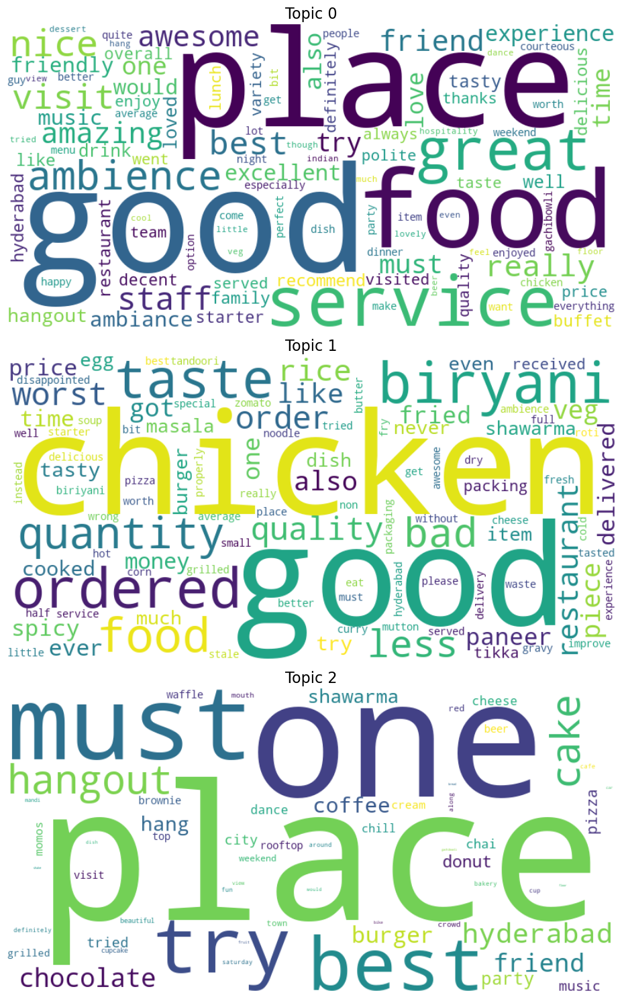

In [19]:
def generate_topic_wordclouds(beta_matrix, vocab, figsize=(15, 5*3)):
    """
    Generate word clouds for each topic.
    """
    num_topics = beta_matrix.shape[0]
    
    # Create subplot for each topic
    fig, axes = plt.subplots(num_topics, 1, figsize=figsize)
    
    # Handle single topic case
    if num_topics == 1:
        axes = [axes]
    
    for topic_idx, ax in enumerate(axes):
        # Create word-weight dictionary for this topic
        word_weights = {}
        for i in range(len(vocab)):
            if i < beta_matrix.shape[1]:  # Make sure index is valid
                weight = beta_matrix[topic_idx, i]
                if weight > 0:  # Only include words with positive weights
                    word_weights[vocab[i]] = weight
        
        # Generate wordcloud
        wordcloud = WordCloud(
            width=800, 
            height=400, 
            background_color='white',
            max_words=100,
            colormap='viridis',
            prefer_horizontal=0.9,
            relative_scaling=0.5,  # Scale word size based partly on word rank
        )
        
        wordcloud.generate_from_frequencies(word_weights)
        
        # Display wordcloud
        ax.imshow(wordcloud, interpolation='bilinear')
        ax.set_title(f'Topic {topic_idx}', fontsize=16)
        ax.axis('off')
    
    plt.tight_layout()
    return fig

# Generate and display topic wordclouds - only call plt.show() once
fig = generate_topic_wordclouds(beta_matrix, vocab_result)
plt.show()

# Step 12: Visualization - Bar Charts of Top Words

This step will:
* Define a function to create bar charts of the most significant words:
  * `visualize_top_words_per_topic()`: Creates horizontal bar charts for each topic
    * Identifies the top words by weight for each topic
    * Sorts words by weight for clear visualization
    * Creates horizontal bar charts with word labels
    * Organizes charts in a vertical layout for easy comparison
* Call the function to display bar charts for all topics

After this step, you'll have bar chart visualizations showing the relative importance of the top words in each topic. These charts provide a more quantitative view than wordclouds, allowing for precise comparison of term weights within and across topics.

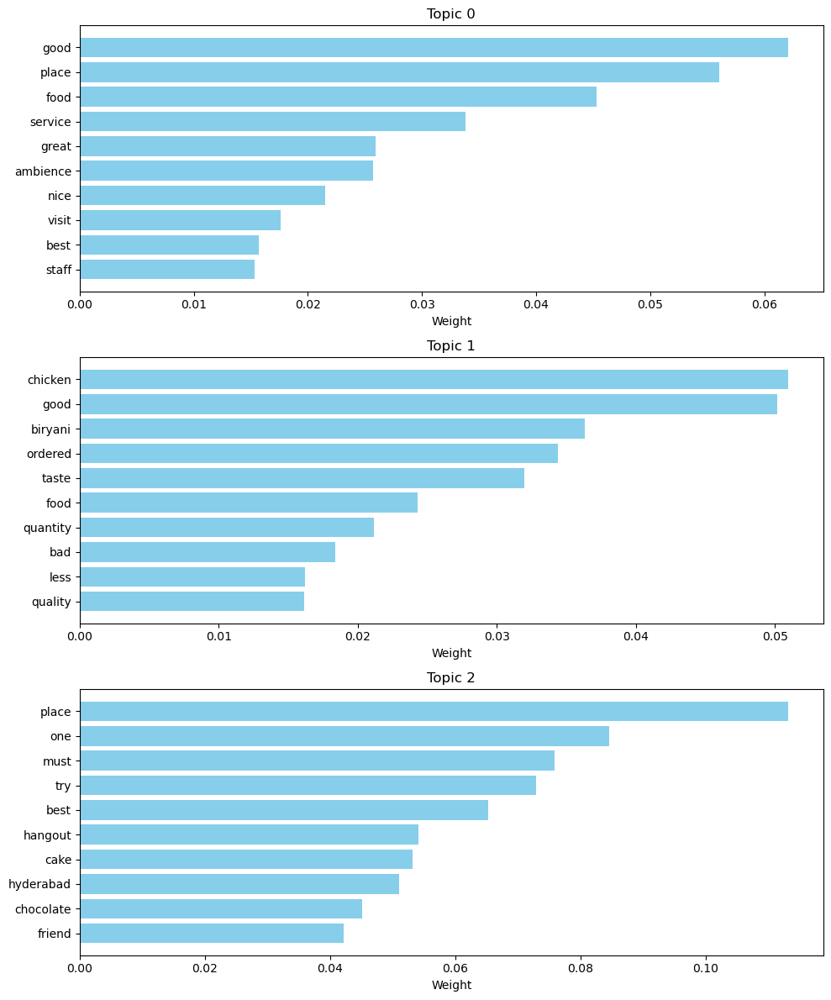

In [20]:
def visualize_top_words_per_topic(beta_matrix, vocab, num_top_words=10):
    """
    Create bar charts of top words for each topic.
    """
    num_topics = beta_matrix.shape[0]
    fig, axes = plt.subplots(num_topics, 1, figsize=(10, 4*num_topics))
    
    # Handle single topic case
    if num_topics == 1:
        axes = [axes]
    
    for topic_idx, ax in enumerate(axes):
        # Get top words for topic
        top_indices = beta_matrix[topic_idx].argsort()[::-1][:num_top_words]
        top_words = [vocab[i] for i in top_indices]
        top_weights = beta_matrix[topic_idx, top_indices]
        
        # Sort by weight
        sorted_indices = np.argsort(top_weights)
        top_words = [top_words[i] for i in sorted_indices]
        top_weights = top_weights[sorted_indices]
        
        # Create horizontal bar chart
        ax.barh(range(len(top_words)), top_weights, color='skyblue')
        ax.set_yticks(range(len(top_words)))
        ax.set_yticklabels(top_words)
        ax.set_title(f'Topic {topic_idx}')
        ax.set_xlabel('Weight')
    
    plt.tight_layout()
    plt.show()

# Create bar charts of top words
visualize_top_words_per_topic(beta_matrix, vocab_result)

# Step 13: Visualization - Topic Similarity Heatmap

This step will:
* Define a function to analyze relationships between topics:
  * `analyze_topic_similarity()`: Calculates and visualizes topic similarities
    * Computes cosine similarity between topic vectors
    * Creates a heatmap visualization of the similarity matrix
    * Adds annotations showing numerical similarity values
    * Labels axes with topic identifiers
* Call the function to display the topic similarity heatmap

After this step, you'll have a heatmap showing how similar or different your topics are from each other. This visualization helps identify redundancy or overlap between topics, which can guide refinement of the model parameters (like adjusting the number of topics) for future runs.

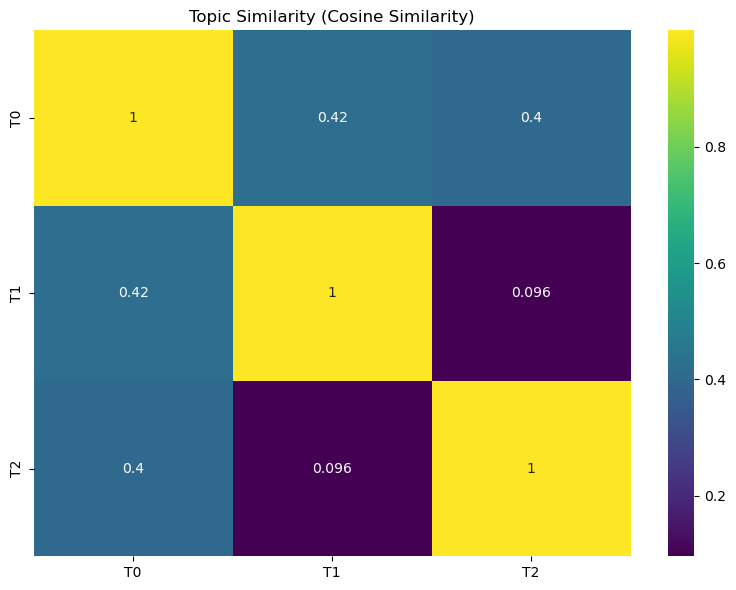

In [21]:
def analyze_topic_similarity(beta_matrix):
    """
    Analyze and visualize similarity between topics.
    """
    # Calculate cosine similarity between topics
    from sklearn.metrics.pairwise import cosine_similarity
    similarity = cosine_similarity(beta_matrix)
    
    # Create heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(similarity, annot=True, cmap='viridis', 
                xticklabels=[f'T{i}' for i in range(beta_matrix.shape[0])],
                yticklabels=[f'T{i}' for i in range(beta_matrix.shape[0])])
    plt.title('Topic Similarity (Cosine Similarity)')
    plt.tight_layout()
    plt.show()

# Analyze topic similarity
analyze_topic_similarity(beta_matrix)

# Step 15: Real-time Interactive Inference Loop

This step will:

* Define core inference functions:
  * `local_prediction()`: Provides a fallback inference method using cosine similarity
  * `preprocess_inference_text()`: Applies consistent text preprocessing for inference
  * `vectorize_inference_text()`: Converts raw text to the proper document-term matrix format
  * `run_inference_complete()`: Handles the full inference pipeline with multiple fallback options
    * First attempts to use the SageMaker endpoint if available
    * Handles various response formats (dictionary or JSON)
    * Falls back to local computation if any errors occur
    * Returns structured topic distribution data
  * `display_inference_result()`: Formats and displays inference results in a readable way

* Implement an interactive command-line interface:
  * `interactive_inference_loop_complete()`: Provides a user-friendly interface for continuous analysis
    * Accepts text input from users until they type "exit"
    * Processes each input through the inference pipeline
    * Displays formatted results showing topic distributions and key words

After this step, you'll have a robust tool for analyzing new text samples with your trained LDA model. The interface works whether or not you have a deployed SageMaker endpoint, automatically using the best available method. When analyzing text, you'll see the overall topic distribution, the dominant topic, and the most significant words for each topic, helping you understand how new content relates to your discovered topics.

In [26]:
# Local prediction function
def local_prediction(vectorized_text, beta_matrix):
    """
    Perform inference locally without using the SageMaker endpoint.
    This is a simple approximation using cosine similarity between document and topic vectors.
    """
    from sklearn.metrics.pairwise import cosine_similarity
    
    # Convert the sparse matrix to dense for cosine similarity calculation
    dense_doc = vectorized_text.toarray()
    
    # Calculate similarity between document and each topic
    similarities = cosine_similarity(dense_doc, beta_matrix)[0]
    
    # Normalize to create a probability distribution
    distribution = similarities / np.sum(similarities)
    
    return {"topic_weights": distribution.tolist()}

# Text preprocessing for inference
def preprocess_inference_text(text):
    """
    Preprocess a single text input for inference.
    Applies the same preprocessing steps used during training.
    """
    text = text.lower()
    text = re.sub(r"http\S+|www\.\S+", "", text)
    text = re.sub(r"<.*?>", " ", text)
    text = re.sub(r"[^a-z\s]", " ", text)
    text = re.sub(r"\s+", " ", text).strip()
    tokens = TOKENIZER.tokenize(text)
    return " ".join([LEMMATIZER.lemmatize(t) for t in tokens if t not in STOP_WORDS])

# Vectorization for inference
def vectorize_inference_text(text, vectorizer):
    """
    Convert preprocessed text to a document-term matrix using the trained vectorizer.
    """
    # Transform the text using the same vectorizer used during training
    dtm = vectorizer.transform([text])
    return dtm

# Complete inference function with multiple fallbacks
def run_inference_complete(text_input, predictor, vectorizer, vocab, beta_matrix, num_topics=3, top_n=5):
    """
    Run inference on a single text input with multiple fallback options.
    """
    try:
        # Preprocess the text
        preprocessed_text = preprocess_inference_text(text_input)
        
        if not preprocessed_text.strip():
            return {"error": "After preprocessing, no valid tokens remain. Please provide more text."}
        
        # Vectorize the text
        dtm = vectorize_inference_text(preprocessed_text, vectorizer)
        
        # Try endpoint inference if available, otherwise use local
        if predictor is not None:
            try:
                # Convert to protobuf format and call the endpoint
                buffer = io.BytesIO()
                write_spmatrix_to_sparse_tensor(buffer, dtm)
                buffer.seek(0)
                
                # Call the endpoint
                response = predictor.predict(buffer.getvalue())
                
                # Handle different response formats
                if isinstance(response, dict) and 'topic_weights' in response:
                    # Response is already a dict with topic_weights
                    topic_distribution = np.array(response['topic_weights'])
                    print("Using endpoint response (dict format)")
                elif isinstance(response, str):
                    # Response is a JSON string
                    topic_distribution = np.array(json.loads(response)['topic_weights'])
                    print("Using endpoint response (JSON string format)")
                else:
                    # Unexpected format - use local inference
                    print("Warning: Unexpected endpoint response format. Using local inference.")
                    local_response = local_prediction(dtm, beta_matrix)
                    topic_distribution = np.array(local_response['topic_weights'])
            except Exception as e:
                # Any endpoint error - use local inference
                print(f"Endpoint error: {str(e)}. Using local inference instead.")
                local_response = local_prediction(dtm, beta_matrix)
                topic_distribution = np.array(local_response['topic_weights'])
        else:
            # No predictor available - use local inference
            print("No endpoint available. Using local inference.")
            local_response = local_prediction(dtm, beta_matrix)
            topic_distribution = np.array(local_response['topic_weights'])
        
        # Format the result with topic weights and top words
        result = {
            "topic_distribution": topic_distribution.tolist(),
            "dominant_topic": int(np.argmax(topic_distribution)),
            "topics": {}
        }
        
        # Add top words for each topic
        for topic_idx in range(num_topics):
            top_indices = np.argsort(beta_matrix[topic_idx])[::-1][:top_n]
            top_indices = [i for i in top_indices if i < len(vocab)]
            top_words = [vocab[i] for i in top_indices]
            top_weights = beta_matrix[topic_idx][top_indices].tolist()
            
            result["topics"][f"topic_{topic_idx}"] = {
                "weight": float(topic_distribution[topic_idx]),
                "top_words": top_words,
                "word_weights": top_weights
            }
        
        return result
    
    except Exception as e:
        logger.error(f"Inference error: {e}")
        return {"error": str(e)}

# Display function remains the same
def display_inference_result(result):
    """
    Display the inference result in a user-friendly format.
    """
    if "error" in result:
        print(f"Error: {result['error']}")
        return
    
    print("\n===== INFERENCE RESULT =====")
    
    # Display overall topic distribution
    print("\nTopic Distribution:")
    for i, weight in enumerate(result["topic_distribution"]):
        print(f"Topic {i}: {weight:.4f}")
    
    # Highlight dominant topic
    dominant_topic = result["dominant_topic"]
    print(f"\nDominant Topic: Topic {dominant_topic} (weight: {result['topics'][f'topic_{dominant_topic}']['weight']:.4f})")
    
    # Display top words for each topic
    print("\nTop Words by Topic:")
    for topic_idx, topic_data in result["topics"].items():
        topic_num = int(topic_idx.split('_')[1])
        print(f"\nTopic {topic_num} (weight: {topic_data['weight']:.4f}):")
        for word, weight in zip(topic_data["top_words"], topic_data["word_weights"]):
            print(f"  {word}: {weight:.4f}")
    
    print("\n============================")

# The complete interactive loop
def interactive_inference_loop_complete(predictor, vectorizer, vocab, beta_matrix, num_topics=3):
    """
    Run an interactive loop with complete fallback handling.
    """
    print("\n==== LDA Model Interactive Inference ====")
    if predictor is not None:
        print("Using endpoint with local fallback")
    else:
        print("Using local inference only (no endpoint)")
    print("Enter text to analyze, or type 'exit' to quit.")
    print("=========================================")
    
    while True:
        # Get user input
        user_input = input("\nEnter text to analyze (or 'exit' to quit): ")
        
        # Check if user wants to exit
        if user_input.lower().strip() == 'exit':
            print("Exiting inference loop.")
            break
        
        # Run inference with complete handling
        result = run_inference_complete(
            user_input, 
            predictor, 
            vectorizer, 
            vocab, 
            beta_matrix, 
            num_topics=num_topics
        )
        
        # Display results
        display_inference_result(result)

# Run the complete interactive loop - handles everything
try:
    print("\nStarting comprehensive LDA inference loop...")
    interactive_inference_loop_complete(predictor, vectorizer, vocab_result, beta_matrix, num_topics=num_topics)
except KeyboardInterrupt:
    print("\nInference loop interrupted by user.")
except Exception as e:
    logger.error(f"Unexpected error: {e}")
    print("Critical error occurred. Please check the logs.")


Starting comprehensive LDA inference loop...

==== LDA Model Interactive Inference ====
Using endpoint with local fallback
Enter text to analyze, or type 'exit' to quit.



Enter text to analyze (or 'exit' to quit):  Worst food ever!



===== INFERENCE RESULT =====

Topic Distribution:
Topic 0: 0.4890
Topic 1: 0.5110
Topic 2: 0.0000

Dominant Topic: Topic 1 (weight: 0.5110)

Top Words by Topic:

Topic 0 (weight: 0.4890):
  good: 0.0621
  place: 0.0561
  food: 0.0453
  service: 0.0338
  great: 0.0259

Topic 1 (weight: 0.5110):
  chicken: 0.0509
  good: 0.0501
  biryani: 0.0363
  ordered: 0.0344
  taste: 0.0320

Topic 2 (weight: 0.0000):
  place: 0.1132
  one: 0.0846
  must: 0.0759
  try: 0.0729
  best: 0.0652




Enter text to analyze (or 'exit' to quit):  exit


Exiting inference loop.


# Step 14: Cleanup Resources (Optional)

This step will:
* Check if resource cleanup is enabled in the configuration
* If cleanup is requested and an endpoint exists:
  * Delete the SageMaker endpoint
  * Log the deletion event

After this step, if cleanup is enabled, all deployed resources will be removed to prevent ongoing charges. This is particularly important for real-time endpoints which continue to incur costs as long as they're running. If cleanup is disabled, the endpoint will remain available for further inference.

In [28]:
if cleanup_resources and predictor is not None:
    predictor.delete_endpoint()
    logger.info(f"Deleted endpoint: {endpoint_name}")
